In [1]:
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Data preprocessing and transformation
from sklearn.preprocessing import MaxAbsScaler, OneHotEncoder

# Clustering
from sklearn.cluster import KMeans

# Dimensionality reduction
from sklearn.manifold import TSNE

# Regression models
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV, ElasticNetCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

# Classification models
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression

# Evaluation metrics
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Model evaluation and selection
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV

C:\Users\monis\AppData\Local\Temp\ipykernel_36080\1689200806.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Loading the dataset

In [2]:
#Reading the dataset
df = pd.read_csv('zomato.csv')

# Understanding the dataset

In [3]:
#Printing the top 5 rows of the original dataset
df.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


In [4]:
#Printing the last 5 rows 
df.tail()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars,Whitefield
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars,Whitefield
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars,Whitefield
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars,Whitefield
51716,https://www.zomato.com/bangalore/the-nest-the-...,"ITPL Main Road, KIADB Export Promotion Industr...",The Nest - The Den Bengaluru,No,No,3.4 /5,13,+91 8071117272,"ITPL Main Road, Whitefield","Bar, Casual Dining",NaN,"Finger Food, North Indian, Continental","1,500","[('Rated 5.0', 'RATED\n Great ambience , look...",[],Pubs and bars,Whitefield


In [5]:
#Printing the number of rows and columns
print(f" Rows in dataset : {df.shape[0]}\n Columns in dataset : {df.shape[1]}")

 Rows in dataset : 51717
 Columns in dataset : 17


In [6]:
#Printing the list of columns
print("Columns in dataset :\n",df.columns)

Columns in dataset :
 Index(['url', 'address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [8]:
df.isnull().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [9]:
#checking unique values for each column
df.nunique()

url                            51717
address                        11495
name                            8792
online_order                       2
book_table                         2
rate                              64
votes                           2328
phone                          14926
location                          93
rest_type                         93
dish_liked                      5271
cuisines                        2723
approx_cost(for two people)       70
reviews_list                   22513
menu_item                       9098
listed_in(type)                    7
listed_in(city)                   30
dtype: int64

In [10]:
df.dtypes

url                            object
address                        object
name                           object
online_order                   object
book_table                     object
rate                           object
votes                           int64
phone                          object
location                       object
rest_type                      object
dish_liked                     object
cuisines                       object
approx_cost(for two people)    object
reviews_list                   object
menu_item                      object
listed_in(type)                object
listed_in(city)                object
dtype: object

# Data Cleaning

In [11]:
# Defining a function to clean 'online_order' and 'book_table' columns
def clean_binary_columns(value):
    if value == 'Yes':
        return 'Y'
    elif value == 'No':
        return 'N'
    else:
        return np.nan

# Cleaning 'online_order' and 'book_table' columns
df['online_order'] = df['online_order'].apply(clean_binary_columns)
df['book_table'] = df['book_table'].apply(clean_binary_columns)

# Removing '/5' from 'rate' and convert to numeric
df['rate'] = df['rate'].str.replace('/5', '')
df['rate'] = pd.to_numeric(df['rate'], errors='coerce')

# Converting 'votes' to numeric
df['votes'] = pd.to_numeric(df['votes'], errors='coerce')

# Removing commas from 'approx_cost(for two people)' and convert to numeric
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].str.replace(',', '')
df['approx_cost(for two people)'] = pd.to_numeric(df['approx_cost(for two people)'], errors='coerce')
      

In [12]:
# Defining a function to clean 'location', 'rest_type', 'cuisines', and 'listed_in(type)' columns
def clean_categorical_columns(value, common_values):
    if pd.isnull(value):
        return pd.NaT
    elif value in common_values:
        return value
    else:
        return 'Other'

# Keeping the top 10 most common locations, restaurant types, and types
top_locations = df['location'].value_counts()[:10].index.tolist()
top_rest_types = df['rest_type'].value_counts()[:10].index.tolist()
top_types = df['listed_in(type)'].value_counts()[:10].index.tolist()

# Cleaning the 'location', 'rest_type', 'cuisines', and 'listed_in(type)' columns
df['location'] = df['location'].apply(clean_categorical_columns, common_values=top_locations)
df['rest_type'] = df['rest_type'].apply(clean_categorical_columns, common_values=top_rest_types)
df['listed_in(type)'] = df['listed_in(type)'].apply(clean_categorical_columns, common_values=top_types)

# Checking for missing values in the data
df.isna().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                           10052
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [13]:
# Imputing the missing values in 'online_order' and 'book_table' with the mode
for col in ['online_order', 'book_table']:
    df[col] = df[col].fillna(df[col].mode().iloc[0])

# Imputing the missing values in 'rate' and 'votes' with the median
for col in ['rate', 'votes']:
    df[col] = df[col].fillna(df[col].median())

# Imputing the missing values in 'location', 'rest_type', 'cuisines', and 'listed_in(type)' with 'Unknown'
for col in ['location', 'rest_type', 'cuisines', 'listed_in(type)']:
    df[col] = df[col].fillna('Unknown')

# Checking for missing values in the data again
df.isna().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                               0
votes                              0
phone                           1208
location                           0
rest_type                          0
dish_liked                     28078
cuisines                           0
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [14]:
# Dropping the 'phone','dish_liked','address', and 'url' columns
df = df.drop(columns=['phone', 'dish_liked','address', 'url'])

# Imputing the missing values in 'approx_cost(for two people)' with the median
df['approx_cost(for two people)'] = df['approx_cost(for two people)'].fillna(df['approx_cost(for two people)'].median())

# Checking for missing values in the data again
df.isna().sum()

name                           0
online_order                   0
book_table                     0
rate                           0
votes                          0
location                       0
rest_type                      0
cuisines                       0
approx_cost(for two people)    0
reviews_list                   0
menu_item                      0
listed_in(type)                0
listed_in(city)                0
dtype: int64

In [15]:
#Renaming few columns for better understanding
df=df.rename(columns={"name":'Restaurant_Name','rate':'Ratings','votes':'Votes','rest_type':'Rest_Type','cuisines':'Cuisines','approx_cost(for two people)':'Cost','listed_in(type)':'Type','listed_in(city)':'Area','online_order':'Online_Order','book_table':'Bookings'})
df.sample(5)

,Restaurant_Name,Online_Order,Bookings,Ratings,Votes,location,Rest_Type,Cuisines,Cost,reviews_list,menu_item,Type,Area
50470,Crunchie Corner,Y,N,4.0,46,Other,Quick Bites,"Fast Food, Continental, Desserts",450.0,"[('Rated 4.0', 'RATED\n The best place for a ...",[],Delivery,Whitefield
25562,Al Amal Cafe,N,N,4.0,74,Other,Other,"Cafe, Fast Food",300.0,"[('Rated 5.0', ""RATED\n Woah woah woah! Never...",[],Delivery,Kammanahalli
17434,Hotel Atithi North Karnataka Mess,N,N,3.7,0,Other,Quick Bites,South Indian,200.0,[],[],Dine-out,HSR
37047,Cool Bites,Y,N,3.7,0,Other,Quick Bites,"Fast Food, Juices",200.0,[],[],Dine-out,Koramangala 7th Block
5486,Red Onion,Y,Y,4.3,550,Other,Casual Dining,"Chinese, North Indian, Biryani, Kebab",1200.0,"[('Rated 5.0', 'RATED\n This place being clos...","['Hyderabadi Biryani', 'Special Veg Combo', 'S...",Delivery,Brigade Road


# Exploratory Data Analysis - Visualization

# 1. How many restaurants in Bangalore take online orders?

Online_Order
Y    30444
N    21273
Name: count, dtype: int64


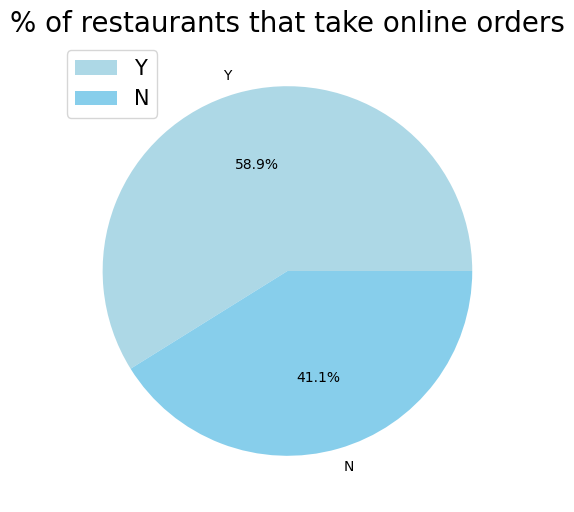

In [16]:
print(df['Online_Order'].value_counts())
plt.figure(figsize=(9,6))
df['Online_Order'].value_counts().plot(kind='pie',colors=['lightblue','skyblue'],autopct='%1.1f%%', textprops={'fontsize': 10})
plt.title('% of restaurants that take online orders',size=20)
plt.xlabel('',size=15)
plt.ylabel('',size=15)
plt.legend(loc=2, prop={'size': 15})

# 2. What percentage of restaurants offer table booking facilities?


Bookings
N    45268
Y     6449
Name: count, dtype: int64


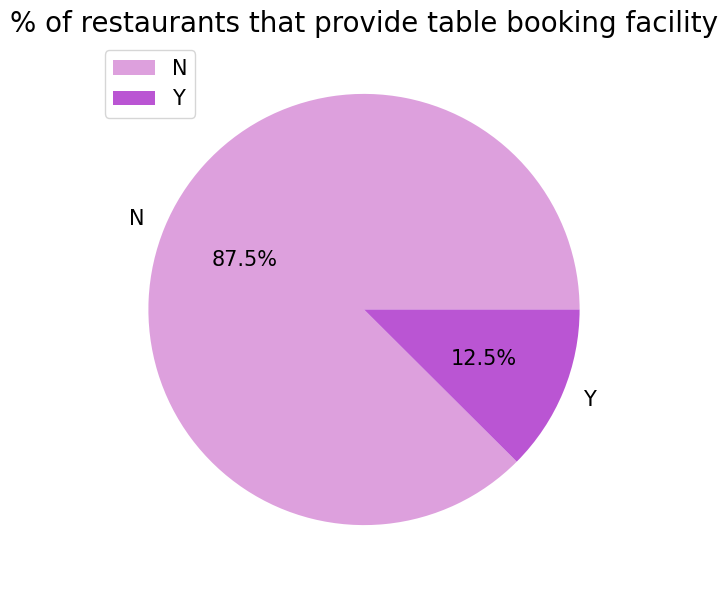

In [17]:
print(df['Bookings'].value_counts())
plt.figure(figsize=(10,7))
df['Bookings'].value_counts().plot(kind='pie',colors=['plum','mediumorchid'],autopct='%1.1f%%', textprops={'fontsize': 15})
plt.title('% of restaurants that provide table booking facility',size=20)
plt.xlabel('',size=15)
plt.ylabel('',size=15)
plt.legend(loc=2, prop={'size': 15})

# 3. What is the most common rating?

Text(0, 0.5, 'Ratings Count')

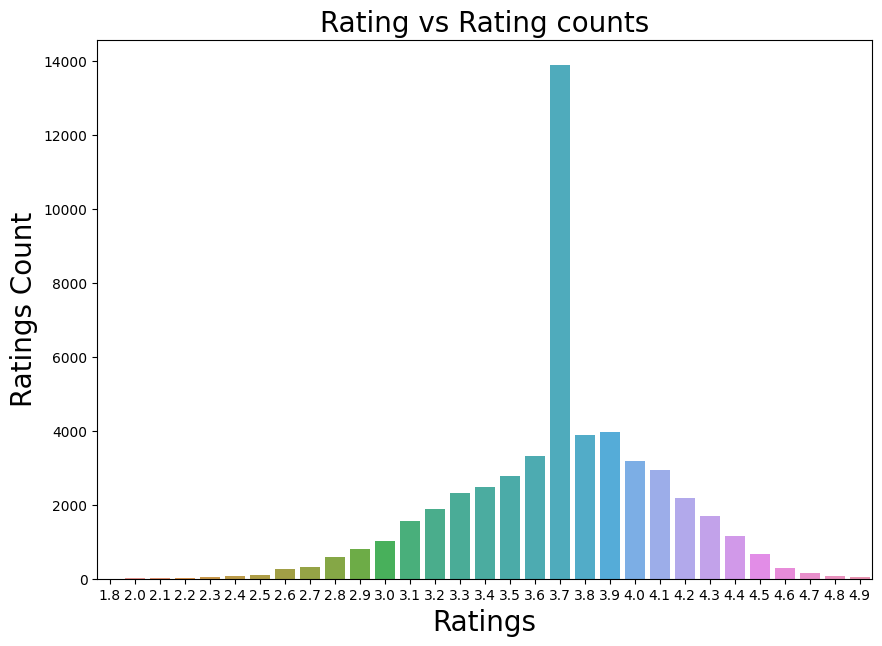

In [18]:
ratings=df.groupby(['Ratings']).size().reset_index().rename(columns={0:"Rating_Count"})
plt.figure(figsize=(10,7))
sns.barplot(x='Ratings',y='Rating_Count',data=ratings)
plt.title('Rating vs Rating counts',size=20)
plt.xlabel('Ratings',size=20)
plt.ylabel('Ratings Count',size=20)

# 4. Which cuisines do customers like the most?

In [19]:
b=df.groupby('Cuisines')['Ratings'].mean().reset_index().sort_values(by='Ratings',ascending=False)
print(b.head(5))

                                               Cuisines  Ratings
1155  Continental, North Indian, Italian, South Indi...      4.9
1469                 Healthy Food, Salad, Mediterranean      4.9
204                         Asian, Chinese, Thai, Momos      4.9
225             Asian, Mediterranean, North Indian, BBQ      4.8
2074         North Indian, European, Mediterranean, BBQ      4.8


# 5.Top 10 most common Restaurant Types

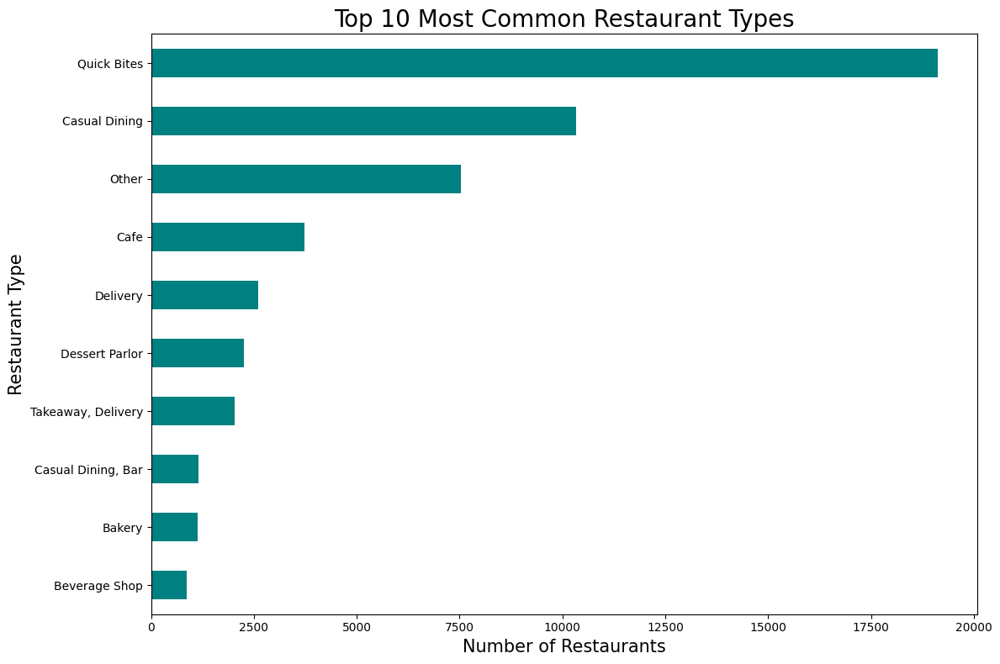

In [20]:
restaurant_type_distribution = df['Rest_Type'].value_counts().nlargest(10)

plt.figure(figsize=(12,8))
restaurant_type_distribution.plot(kind='barh', color='teal')
plt.title('Top 10 Most Common Restaurant Types', fontsize=20)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Restaurant Type', fontsize=15)
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# 6. Areas Vs Count of Restaurants taking online orders

In [21]:
df1 = pd.pivot_table(df, index = ['Area'], columns = 'Online_Order', aggfunc = 'size')
df1

Online_Order,N,Y
Area,,
BTM,1148,2131
Banashankari,317,546
Bannerghatta Road,607,1010
Basavanagudi,472,794
Bellandur,406,821
Brigade Road,853,916
Brookefield,552,966
Church Street,939,888
Electronic City,665,564


<Axes: xlabel='Area'>

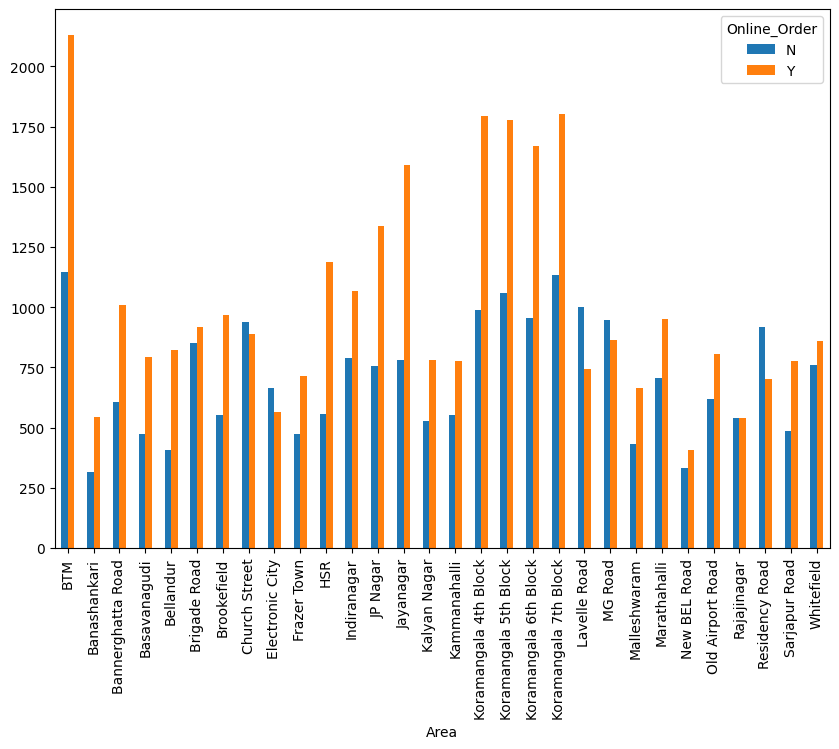

In [22]:
df1.plot(kind = 'bar' , figsize = (10,7))

# 7. What is the average price for two people based on the type of service?

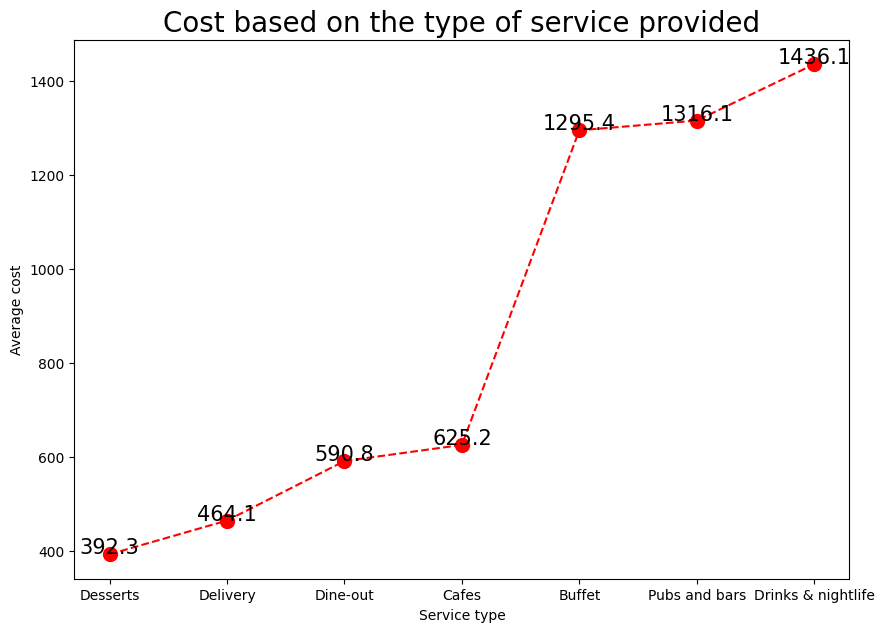

In [23]:
d=df.groupby('Type')['Cost'].mean().reset_index().sort_values(by='Cost')
plt.figure(figsize=(10,7))
plt.plot(d['Type'],d['Cost'],'o--r',ms=10)
plt.xlabel('Service type',size=10)
plt.ylabel('Average cost',size=10)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.title('Cost based on the type of service provided',size=20)
for i,e in enumerate(d.Cost):
    plt.text(i,e+1,round(e,1),fontsize=15,horizontalalignment='center')
plt.show()

# 8. To compare the distributions of 'rate', 'votes', and 'approx_cost(for two people)' for online order accepting and non-accepting restaurants

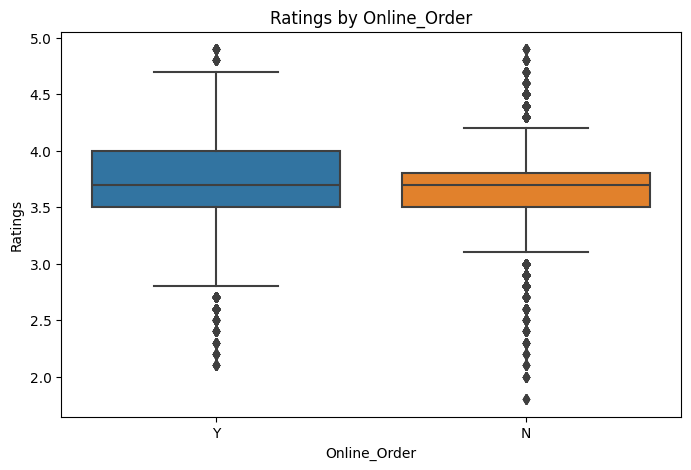

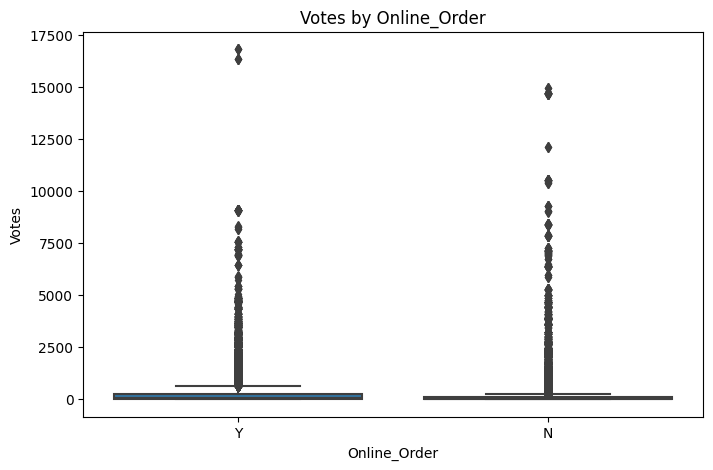

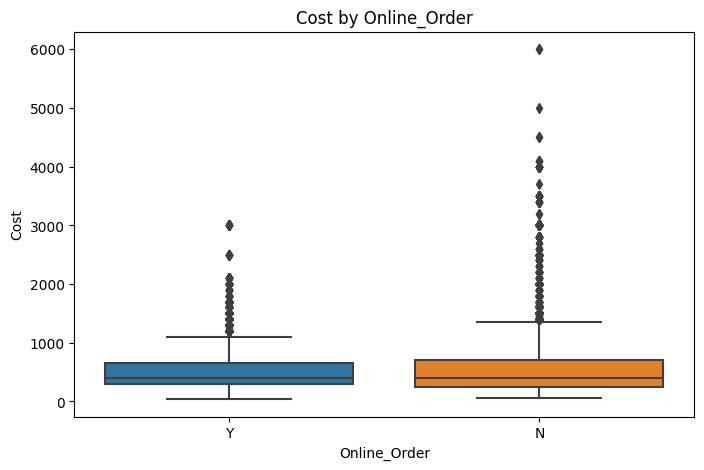

In [24]:
for col in ['Ratings', 'Votes', 'Cost']:
    plt.figure(figsize=(8, 5))
    sns.boxplot(x='Online_Order', y=col, data=df)
    plt.title(f'{col} by Online_Order')
    plt.show()

# 9. Plot histograms for the numerical columns

C:\Users\monis\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


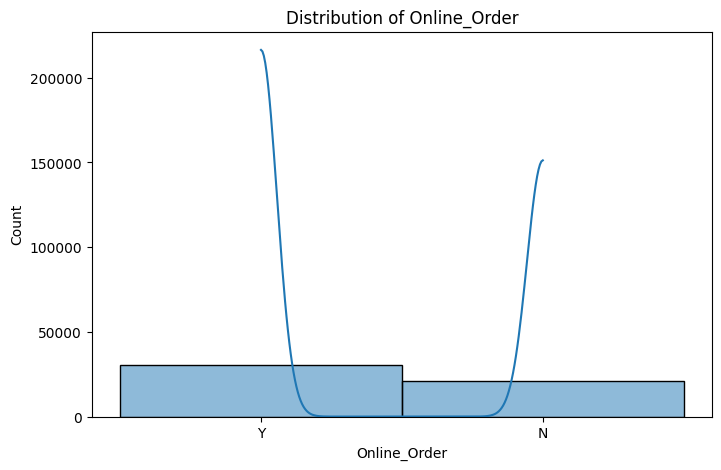

C:\Users\monis\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


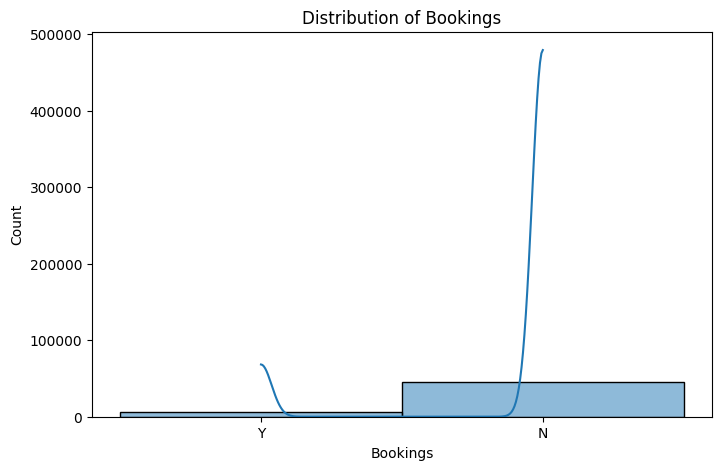

C:\Users\monis\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


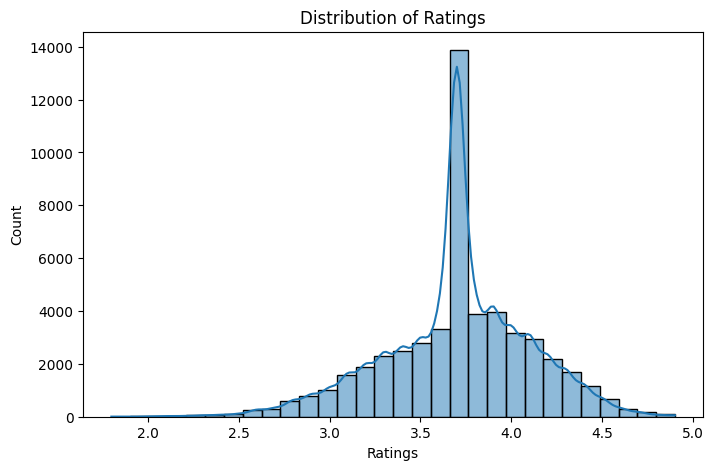

C:\Users\monis\AppData\Roaming\Python\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


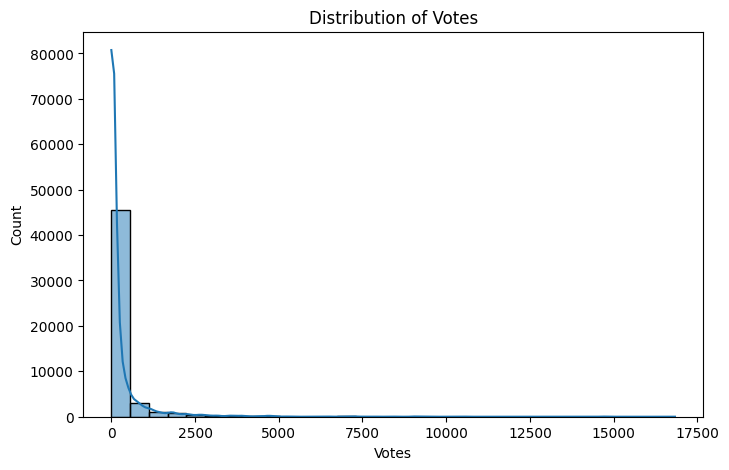

In [25]:
numerical_cols = ['Online_Order', 'Bookings', 'Ratings', 'Votes']
for col in numerical_cols:
    plt.figure(figsize=(8, 5))
    sns.histplot(df[col], bins=30, kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

# Feature Engineering

In [26]:
# Creating a new column expensive and considering a restaurant to be expensive if the cost (avg_cost_of_two) > median_cost
median_cost = df['Cost'].median()
df['expensive'] = df['Cost'].apply(lambda x: 1 if x > median_cost else 0)

df = df.drop(columns='Cost')
df.head()

,Restaurant_Name,Online_Order,Bookings,Ratings,Votes,location,Rest_Type,Cuisines,reviews_list,menu_item,Type,Area,expensive
0,Jalsa,Y,Y,4.1,775,Other,Casual Dining,"North Indian, Mughlai, Chinese","[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari,1
1,Spice Elephant,Y,N,4.1,787,Other,Casual Dining,"Chinese, North Indian, Thai","[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari,1
2,San Churro Cafe,Y,N,3.8,918,Other,Other,"Cafe, Mexican, Italian","[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari,1
3,Addhuri Udupi Bhojana,N,N,3.7,88,Other,Quick Bites,"South Indian, North Indian","[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari,0
4,Grand Village,N,N,3.8,166,Other,Casual Dining,"North Indian, Rajasthani","[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari,1


# Sentiment Analysis based on 'Reviews_List'

In [27]:
!pip install TextBlob

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [28]:
from textblob import TextBlob

# Function to extract review texts from the reviews_list column
def extract_reviews(review_data):
    reviews = []
    for entry in review_data:
        # Splitting the entry to isolate the review part
        print(entry)
        print("Length of entry: ",len(entry))
        if len(entry)>1:
            review = entry[1]

            
            reviews.append(review)
    return reviews

df['cleaned_reviews'] = df['reviews_list'].apply(lambda x: extract_reviews(eval(x)))


('Rated 4.0', 'RATED\n  A beautiful place to dine in.The interiors take you back to the Mughal era. The lightings are just perfect.We went there on the occasion of Christmas and so they had only limited items available. But the taste and service was not compromised at all.The only complaint is that the breads could have been better.Would surely like to come here again.')
Length of entry:  2
('Rated 4.0', 'RATED\n  I was here for dinner with my family on a weekday. The restaurant was completely empty. Ambience is good with some good old hindi music. Seating arrangement are good too. We ordered masala papad, panner and baby corn starters, lemon and corrionder soup, butter roti, olive and chilli paratha. Food was fresh and good, service is good too. Good for family hangout.\nCheers')
Length of entry:  2
('Rated 2.0', 'RATED\n  Its a restaurant near to Banashankari BDA. Me along with few of my office friends visited to have buffet but unfortunately they only provide veg buffet. On inquirin

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.0', 'RATED\n  I accidentally stumbled upon this restaurant while browsing in Zomato ordered one veg thali was pleasantly surprised by the food which was delivered it was nicely packed, the quality and quantity was also very good, it felt like I was eating home cooked food and tasty specially the pepper aloo preparation was just awesome keep the good work going try some other dishes also.')
Length of entry:  2
('Rated 5.0', 'RATED\n  M meri family ke sath bangalore gyi wha maine apni rasoi restaurant me ek thali order ki wow mtlb kya khana tha missi roti ,lassi lazawaab the .agr muje dobara banglore jane ka mouka mila to m apni rasoi restaurant me jrur jaungi.')
Length of entry:  2
('Rated 1.0', 'RATED\n  Ordered gobhi Manchurian and Kadhi pakoda with roti.While kadhi pakoda was ok gobhi was stale.No more ordering from this place.\n\nThey need to make sure they serve fresh food')
Length of entry:  2
('Rated 5.0', 'RATED\n \nFood was really good.Keep up the good work .\nDeliver

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Length of entry:  2
('Rated 1.0', 'RATED\n  While it was Ok when it opened - the quality of food and service have gone down drastically. I visited them yesterday and found the entire team just running around with no direction. Nothing tasted good and half the starters were probably frozen and not fresh. Also found a live insect in fruit salad and they served chicken sushi when my son asked for some veg ones. ( which is unpardonable ) Overall terrible place after yesterdays experience and will probably never go again.')
Length of entry:  2
('Rated 4.0', 'RATED\n  I had a visit to Flechazo on an lovely Monday afternoon. Place got good ambience. Service was quick and staff were friendly. Flechazo has wide range of varieties available on their menu and food tasted fabulous, especially indian deserts. Overall it was an good experience.Keep up the good work. kudos!!')
Length of entry:  2
('Rated 5.0', 'RATED\n  I had earlier been to the marathahalli outlet of flechazzo and was really impress

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.5', "RATED\n  What better option than a pizza when it's late night and most options are closed.... Ordered half a dozen pizzas and a couple of burgers... Was delivered within satisfactory time.... But the taste was the icing on the cake.... Not to forget the inaugural discounts... There's a bit of home made feel to their dishes and maybe that what sets them apart... A definite option here onwards for the late night binge sessions...")
Length of entry:  2
('Rated 5.0', "RATED\n  There's no better feeling in the world than a warm pizza box on your lap. I love that yummy pizza ..! I would definitely recommend this place for late night unplanned parties!")
Length of entry:  2
('Rated 4.0', 'RATED\n  Must say that the the quantity of a pizza would fill 2 people like me. Got a crazzy discount on my order. Must try pizzas intense cheese n meat.')
Length of entry:  2
('Rated 5.0', 'RATED\n  The best part about sharing a pizza with a friend is the joy it brings into the life of both f

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 3.0', 'RATED\n  Amazing Thai food! My first experience was great. Loved the flavors and the simplicity. When I ordered food through zomato, the quantity and food was very average. I really hope that the take away quantity increases, because it was really disappointing to open a box which was half full.')
Length of entry:  2
('Rated 4.0', "RATED\n  My friend and I stumbled upon this joint on our monthly Church Street visits. It was raining heavily so we entered 5th Avenue Mall with no intention to eat at this joint. But when the server offered us the menu, we decided to give it a shot and ordered soup, crispy tofu salad and sticky rice dessert. \n\nNow I generally hate tofu but their crispy tofu salad was an absolute delight. I am sure I'd be definitely going back for the tofu salad and the refreshingly light soup. \n\nDessert- Didnt like the Sticky rice dessert but it was an interesting order considering it was alarmingly blue. I felt like I was trying into a smurf eating the d

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




('Rated 5.0', 'RATED\n  This rooftop cafe is very near to where we are put up . Heard a lot about this cafe and their unlimited food menu. Sordhan langthasa served us here and he was really nice and courteous . Loved the ambience , the food and their hospitality. And we got complimentary desserts which was amazing ?')
Length of entry:  2
('Rated 4.0', 'RATED\n  This was my third onesta visit at the third location. Earlier i had visited Onesta in Marathalli and Indiranagar. This place has never disappointed me.\n\nThis time i went to avail the "name of the week - eena" offer. My friend has "eena" in her name.\n\nAmbience is quite good. It is an Italian rooftop restaurant. Their ceiling has lot of plants.\nThe service is great here. They offer wide variety of pizza\'s, out of which we ordered Chicken tikka pizza, Chat pizza, Spinach corn pizza. The taste was decent. Desserts are a must try here.\n\nPrice was very reasonable. This place is good for team lunch or dinner.\n\nFood: 4\nServi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.0', 'RATED\n  Well, I never had a chance to visit the place. But these guys are surely working out some recipe seriously! I just love the food they serve. It has been, I guess 2 weeks straight, I have been ordering from them.\nFood feels home. Even though I always opted for a delivery, I was never disappointed with their serving and delivery. The food is really hot when delivered and its a bliss to get food served hot mode being delivery....\nJust awesome! Keep it up! Cheers!\n\nBeware "sometimes" they goof-up real bad on their food.. I ordered something and got something today!\n\n#happystomach..')
Length of entry:  2
('Rated 5.0', "RATED\n  The owner is very friendly and cooperative. The food very homely. It's extremely tasty. Price is very affordable. Everything in the menu is good. A must visit.")
Length of entry:  2
('Rated 2.0', "RATED\n  Soo after a tiring day, I decided to try out their food. I had ordered for a Make your own meal which comprised Dal, Vegetable curry 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.0', 'RATED\n  Great cakes at pocket friendly rates. Love their rich chocolate cake and brownies.\nThey served me a cake of my liking(intense dark)in short notice of just 20 min. Friendly and helpful staff.\nMy favourites are choco vanilla and dark chocolate cakes. My friends tried few other items and they said they were good too.')
Length of entry:  2
('Rated 4.0', 'RATED\n  Multi Cakes is one place for all kind of cakes with fabulous flavours and shapes. Have been to this outlet many a times and never being disappointed.\nTry their butterscotch and blueberries cakes...yum...')
Length of entry:  2
('Rated 3.5', 'RATED\n  Cakes are delicious here.. I bought the pineapple cake and just loved the softness and taste.. They do maintain a lot of variety are little expensive..')
Length of entry:  2
('Rated 2.0', 'RATED\n  Senseless pricing, and very less quantity. Staff people are arrogant and do not have manners to talk. Inside shop no Dustbins. Not worth walking into sucha place. 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 1.0', "RATED\n  The restaurant delivery boy cannot enter the apartment to deliver. Somehow he comes in, gives the food and takes it back as a revenge!! I have never seen such a rude delivery boy!! This restaurant sucks! Please be more polite and customer friendly if you have to survive in the market. My suggestion is, never order from Crunch Pizzas if you really want to eat. It's better to starve than order from this place.")
Length of entry:  2
('Rated 1.0', 'RATED\n  Very bad Service...and They are making customers a fool.\nVery Worst and Bad service...they took 2 hours for my Order and ddnt deliverd. ...last they cancelled')
Length of entry:  2
('Rated 1.0', 'RATED\n  One of waste pizzas hates pizza in first looks but some smell from pizza not able to have such a waste of money. No interest to order Futher in zomato')
Length of entry:  2
('Rated 4.0', 'RATED\n  give more options on the crust')
Length of entry:  2
('Rated 1.0', 'RATED\n  very bad customer service, when I call

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 1.0', 'RATED\n  a worst service ever. \nordered for 2 mutton biryani and a pepper chicken.\nordered food at 10.40 , it reached me at 12.40. \n\nmoreover they missed one mutton biryani and they didnt even say sorry for that.\nwas starving from hunger and this happens. hope no one orders from this place. may be they are providing food late nights but we are paying for it and more over they were not sorry for wat happened. they were asking me to wait for another half hour to deliver the other biryani.\n\ni asked the delivery boy to take back the food. \nfrom here on i would not order the food from this place.')
Length of entry:  2
('Rated 1.0', "RATED\n  I would never order from this restaurant again. The delivery was late and the delivery boy didn't have change...he rushed for an other delivery came back late night,woke us late night for change.")
Length of entry:  2
('Rated 1.0', 'RATED\n  100 % Assured that food arrives late though efforts are highly appreciated but please you 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.0', 'RATED\n  Good food, awesome drinks ,good service and great music selection.\nWe ordered fish fingers, cheese fingers, chicken special recipes, and chicken ghee roast all were atits best.')
Length of entry:  2
('Rated 4.0', "RATED\n  A cool, happening place with music and beer!\nMust try is the crispy chicken pizza and moctails.\nI didn't really like the burger though.\nLooking forward to try other dishes from the menu.")
Length of entry:  2
('Rated 3.0', 'RATED\n  A decent place where you will get a seating even on a busy Friday night. The food is average. We had ordered Prawns and Chicken starters which were just ok. Even the peanuts had too much salt in them. Visit this place only if there is no other option or you do not like too much crowd.')
Length of entry:  2
('Rated 4.0', 'RATED\n  A cool place to hangout with your friends and colleagues. They have an open sitting arrangement as well which is ideal for dinner dates or late office parties.\nI highly recommend visi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 3.0', 'RATED\n  I ordered Chilly Paneer, Bag of Fries & Berry Cooler.\nChilly Paneer - Paneer was really fresh & soft, good in taste but would not rate it excellent.\nBag of Fries - French fries & cheese balls were yummy but onion rings & potato snack were average in taste.\nBerry Cooler - A big NO to order this.\n\nP.S. - It is a non alcoholic place.\n\nAmbience was not so good but staff was friendly.')
Length of entry:  2
('Rated 3.0', "RATED\n  Out of the three starters we tried only the peri peri baked chicken wings had a delicious saucy topping and good flavours. The Korean bbq chicken was average. More like stir fryed chicken with capsicum and a bit of gravy. The tandoori broccoli is a completely disaster. It is like a malai coating on broccoli. Def not one of the best flavor combinations. You can literally taste the hints of sweetness and cardamom and that's quite a put off.\n\nIn terms of decor, the place is pretty well done and quite literally gives the feel of an atti

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



2
('Rated 4.0', 'RATED\n  This place is Neat !!\nFound this place While searching for Raw Papaya Salad ...!!!\nDesserts , beverages and every other thing on the menu is reasonably priced ..\nGood service too !!')
Length of entry:  2
('Rated 3.0', 'RATED\n  When you need your food to be the cleanest possible. Homely taste, no extra added flavours. Some times your dish might go wrong, like the paneer which they fried and tasted crazy.\nThe ambience is nice and a Silent one. However the silence was disturbed by the background music. Hope they could switch off the loud music at times.')
Length of entry:  2
('Rated 5.0', 'RATED\n  Great food & a peaceful place to eat at. Ordered for blueberry pancakes , very berry waffles, chicken salami focaccia and mango passion. Loved the pancakes & focaccia . Will def visit it again.')
Length of entry:  2
('Rated 3.0', 'RATED\n  PANCAKES 3/5 : their batter did not seem fresh\n\nWaffles 1/5 they were nlt criwpy at all and tasted like a pancake which was 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 4.0', 'RATED\n  I have been ordering from here often.the food is quite homely and good in quality as well as quantity.Talking about ambiance,it is ok ok but their service is good')
Length of entry:  2
('Rated 3.0', "RATED\n  The food was pretty decent as compared to the other places where we get really not-so-North Indian food.\n\nService wasn't good enough. Slow as well as ineffective. It's a small place with relatively simple chairs.")
Length of entry:  2
('Rated 3.0', "RATED\n  Mast Kalandar - a small restaurant on the 4th block if you are looking for pure vegetarian food. Although the place is very clean, has a decent enough ambience and has food at reasonable rates - doesn't attract too many customers. They have quick bites and lots of options to pick from but the best part is their combos.  Have tried a couple of Halka Phulka combos, and I must say that although the food isn't mouthwatering or delicious, it can pass off as a good meal on a broke day! The affordable prices

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 5.0', "RATED\n  Oh oh oh!!! It's the coolest place ..I just loved it..the foods are so delicious..those ice cream rolls were just awesome.. everyone must visit Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â°Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x9fÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x92Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â«")
Length of entry:  2
('Rated 3.0', "RATED\n  We ordered hot chocolate fudge and tandoori nuggets .The chocolate sauce for the fudge wasn't even hot. Employees were busy playing games on phone. Tandoori nuggets were good.")
Length of entry:  2
('Rated 5.0', 'RATED\n  Why get stoned when you can get rolled! Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â°Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x9fÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x98Ã\x83\x83Ã\x82\x83Ã\x83\x

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 1.0', 'RATED\n  Pathetic food.. the only time someone can recommend this place is that if you hadnÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x99t had cholera ever. Trust me the food here is very very bad')
Length of entry:  2
('Rated 4.0', 'RATED\n  Worth the money,Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x9dPocket FriendlyÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x9d..good number of varieties,great service and taste..rolls-tikka and shawarma rolls,combo biriyaniÃ\x83\x83Ã\x82\x83

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Length of entry:  2
('Rated 1.0', 'RATED\n  Why was I here? Cheap booze (Standee outside helped us make this unwise decision)\nWhat did I do here? Had a cola and quickly left.\nWhy did I not want to be here? ItÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x99s a shady bar! You donÃ\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x99t need much brains to figure that out Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x83Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82Â¢Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x80Ã\x83\x83Ã\x82\x83Ã\x83\x82Ã\x82\x82Ã\x83\x83Ã\x82\x82Ã\x83\x82Ã\x82\x93 flat 5 minutes is what you need.\n\nSummary: Ladies, Alibi is the last place that you w

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Length of entry:  2
('Rated 3.5', "RATED\n  Very small place it's actually know for thandoori food. Also the shawarmas taste good. They are quite fast and good Ambience. I liked the shawarmas here, price is decent.")
Length of entry:  2
('Rated 2.5', "RATED\n  With not much expectations from this place , went once to try their Shawarma (Arabian) and it was 'meh' in my opinion. It's sometimes not wise not to judge the rest of their menu which might be good/Ok but it's a mediocre place and nothing convinced me to visit this place again.")
Length of entry:  2
('Rated 3.5', "RATED\n  TFC  isn't too big on size, but they do cover up for that with pretty decent tandoori. They serve up brilliant shawarmas and epic kababs. Their malai and reshmi kababs are my favourites. The fried rice isn't too good and there is no way you can sit down and eat there. Good place to get a quick snack.\nFood - 3.5\nAmbience - 1\nService(time) - 3.5\nPrice - 4.0\nOverall - 3.5")
Length of entry:  2
('Rated 3.0',

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Length of entry:  2
('Rated 5.0', 'RATED\n  food was tasty and good quality')
Length of entry:  2
('Rated 3.0', 'RATED\n  not worth for money')
Length of entry:  2
('Rated 5.0', 'RATED\n  nice food')
Length of entry:  2
('Rated 5.0', 'RATED\n  Pepper chicken was tooooo good')
Length of entry:  2
('Rated 5.0', 'RATED\n  good')
Length of entry:  2
('Rated 5.0', 'RATED\n  food was tasty and good quality')
Length of entry:  2
('Rated 5.0', 'RATED\n  good')
Length of entry:  2
('Rated 5.0', 'RATED\n  very tasty')
Length of entry:  2
('Rated 1.0', 'RATED\n  chicken curry was bad')
Length of entry:  2
('Rated 4.0', 'RATED\n  good')
Length of entry:  2
('Rated 5.0', 'RATED\n  hungry Savior super taste delivered on time everything is awesome')
Length of entry:  2
('Rated 5.0', 'RATED\n  good')
Length of entry:  2
('Rated 5.0', 'RATED\n  very tasty')
Length of entry:  2
('Rated 1.0', 'RATED\n  chicken curry was bad')
Length of entry:  2
('Rated 4.0', 'RATED\n  good')
Length of entry:  2
('Rated 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



('Rated 1.0', "RATED\n  Having been ordering food from nu.tree almost back since it started and they have have served delicious home like food. There are some bad days when there might be a thing amiss or two but the food wasn't inedible ever.\n\nBut that changed today as I ordered a Dal Khichdi which I have relished many a times before only to be delivered some watery concoction of rice and some vegetables. It didn't look like a mistake but more like they just didn't care about what they were serving anymore.\n\nHoping it's not true & they continue to serve delicious food but not to sure I'll be the one they'll be serving anytime soon.")
Length of entry:  2
('Rated 4.0', 'RATED\n  My go to place to order Gobhi paranthas. Aaloo is also good; paneer can be avoided. Good packaging. Green chutney that comes with the paranthas is delicious; just increase the quantity of it !!')
Length of entry:  2
('Rated 4.0', 'RATED\n  Happy to see few delivery chains breaking the myth that healthy food 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




('Rated 5.0', 'RATED\n  nice paneer biryani')
Length of entry:  2
('Rated 4.0', 'RATED\n  Prize is worth but not satisfied with quantity')
Length of entry:  2
('Rated 3.0', "RATED\n  The biriyani was absolutely appalling. It didn't have no taste no flavours, you top it all the paneer pieces in it were smelling disgusting and also had that stale and rotten sour taste in it. I had to throw the entire food. I am really surprised that they made it so far, it's a miracle!!\n\nThe Manager from the restaurant called me and assured of good food going ahead. He also mentioned that he has initiated a 100% refund for the same. He advised that their Paneer Biriyani is a bestseller, this was an one of mistake. He was courteous and assuring and that's why I think they deserves another shot.")
Length of entry:  2
('Rated 5.0', 'RATED\n  very fast service')
Length of entry:  2
('Rated 4.0', 'RATED\n  biryani was good taste and quantity wise')
Length of entry:  2
('Rated 5.0', 'RATED\n  nice paneer bi

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [29]:

# Applying sentiment analysis on the extracted reviews
def analyze_sentiment(reviews):
    sentiments = []
    for review in reviews:
        blob = TextBlob(review)
        if blob.sentiment.polarity > 0:
            sentiments.append('positive')
        elif blob.sentiment.polarity == 0:
            sentiments.append('neutral')
        else:
            sentiments.append('negative')
    return sentiments

# Applying sentiment analysis to each list of reviews
df['sentiments'] = df['cleaned_reviews'].apply(analyze_sentiment)




In [30]:
df.head()

,Restaurant_Name,Online_Order,Bookings,Ratings,Votes,location,Rest_Type,Cuisines,reviews_list,menu_item,Type,Area,expensive,cleaned_reviews,sentiments
0,Jalsa,Y,Y,4.1,775,Other,Casual Dining,"North Indian, Mughlai, Chinese","[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari,1,[RATED\n A beautiful place to dine in.The int...,"[positive, positive, positive, positive, posit..."
1,Spice Elephant,Y,N,4.1,787,Other,Casual Dining,"Chinese, North Indian, Thai","[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari,1,[RATED\n Had been here for dinner with family...,"[positive, positive, positive, positive, posit..."
2,San Churro Cafe,Y,N,3.8,918,Other,Other,"Cafe, Mexican, Italian","[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari,1,[RATED\n Ambience is not that good enough and...,"[positive, positive, positive, positive, negat..."
3,Addhuri Udupi Bhojana,N,N,3.7,88,Other,Quick Bites,"South Indian, North Indian","[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari,0,[RATED\n Great food and proper Karnataka styl...,"[positive, negative, positive, positive, posit..."
4,Grand Village,N,N,3.8,166,Other,Casual Dining,"North Indian, Rajasthani","[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari,1,[RATED\n Very good restaurant in neighbourhoo...,"[positive, positive]"


In [31]:
# Displaying a part of the dataframe to see the results
df[['Restaurant_Name','reviews_list', 'cleaned_reviews', 'sentiments']].head(50)

,Restaurant_Name,reviews_list,cleaned_reviews,sentiments
0,Jalsa,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[RATED\n A beautiful place to dine in.The int...,"[positive, positive, positive, positive, posit..."
1,Spice Elephant,"[('Rated 4.0', 'RATED\n Had been here for din...",[RATED\n Had been here for dinner with family...,"[positive, positive, positive, positive, posit..."
2,San Churro Cafe,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[RATED\n Ambience is not that good enough and...,"[positive, positive, positive, positive, negat..."
3,Addhuri Udupi Bhojana,"[('Rated 4.0', ""RATED\n Great food and proper...",[RATED\n Great food and proper Karnataka styl...,"[positive, negative, positive, positive, posit..."
4,Grand Village,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[RATED\n Very good restaurant in neighbourhoo...,"[positive, positive]"
5,Timepass Dinner,"[('Rated 3.0', 'RATED\n Food 3/5\nAmbience 3/...",[RATED\n Food 3/5\nAmbience 3/5\nService 3/5\...,[positive]
6,Rosewood International Hotel - Bar & Restaurant,"[('Rated 5.0', 'RATED\n Awesome food ??Great ...",[RATED\n Awesome food ??Great serviceFriendly...,"[positive, positive]"
7,Onesta,"[('Rated 5.0', 'RATED\n I personally really l...",[RATED\n I personally really liked this place...,"[positive, positive, positive, negative, posit..."
8,Penthouse Cafe,"[('Rated 3.0', ""RATED\n I had been to this pl...",[RATED\n I had been to this place with one of...,"[positive, positive, positive, positive, posit..."
9,Smacznego,"[('Rated 4.0', ""RATED\n Easy to locate\nVFM 3...",[RATED\n Easy to locate\nVFM 3.5/5\nTaste 5/5...,"[positive, positive, positive, positive, posit..."


In [32]:
#Defining a function such that it takes the average of the reviews and conclude as positive or negative
def handleSentiments(sentiments):
    count_pos = 0
    count_neg = 0
    for sent in sentiments:
        if sent == 'positive':
            count_pos += 1
        else:
            count_neg += 1

    if count_pos > len(sentiments)//2:
        return 'positive'
    else:
        return 'negative'

df['sentiments'] = df['sentiments'].apply(lambda x: handleSentiments(x))
df.head()

,Restaurant_Name,Online_Order,Bookings,Ratings,Votes,location,Rest_Type,Cuisines,reviews_list,menu_item,Type,Area,expensive,cleaned_reviews,sentiments
0,Jalsa,Y,Y,4.1,775,Other,Casual Dining,"North Indian, Mughlai, Chinese","[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari,1,[RATED\n A beautiful place to dine in.The int...,positive
1,Spice Elephant,Y,N,4.1,787,Other,Casual Dining,"Chinese, North Indian, Thai","[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari,1,[RATED\n Had been here for dinner with family...,positive
2,San Churro Cafe,Y,N,3.8,918,Other,Other,"Cafe, Mexican, Italian","[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari,1,[RATED\n Ambience is not that good enough and...,positive
3,Addhuri Udupi Bhojana,N,N,3.7,88,Other,Quick Bites,"South Indian, North Indian","[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari,0,[RATED\n Great food and proper Karnataka styl...,positive
4,Grand Village,N,N,3.8,166,Other,Casual Dining,"North Indian, Rajasthani","[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari,1,[RATED\n Very good restaurant in neighbourhoo...,positive


In [33]:
print('Positives:',len(df[df['sentiments'] == 'positive']))
print('Negatives:',len(df[df['sentiments'] == 'negative']))

Positives: 37321
Negatives: 14396


# Machine Learning Models

In [36]:
df1=df
#dropping the column that contains list so that onehotencoding can be done
df1=df1.drop(columns='cleaned_reviews', inplace=True)


KeyError: "['cleaned_reviews'] not found in axis"

In [37]:
# Selecting the predictor and the target variable
X = df1.drop(columns='expensive')
y = df1['expensive']

# One-hot encoding to the categorical variables
encoder = OneHotEncoder(drop='first')
X_encoded = encoder.fit_transform(X)

# Splitting the data into a training set and a test set
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# The shapes of the training set and the test set
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((41373, 45540), (10344, 45540), (41373,), (10344,))

In [38]:
# Scaling the data with MaxAbsScaler
scaler = MaxAbsScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


# Classification Model : If a Restaurant is expensive or not

In [39]:
#using 3 ML models for classification
models = [
    ('Logistic Regression', LogisticRegression(max_iter=1000, random_state=42)),
    ('Decision Tree', DecisionTreeClassifier(max_depth=10, random_state=42)),
    ('Random Forest', RandomForestClassifier(random_state=42)),
    ]

# Train, predict, and evaluate each model
model_scores = []
for name, model in models:
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    model_scores.append((name, accuracy, precision, recall, f1))

# Create a dataframe to store the scores of all models
model_scores_df = pd.DataFrame(model_scores, columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score'])

# Display the scores of all models
model_scores_df

,Model,Accuracy,Precision,Recall,F1 Score
0,Logistic Regression,0.966357,0.976106,0.952748,0.964286
1,Decision Tree,0.842421,0.950587,0.706145,0.810333
2,Random Forest,0.965971,0.981493,0.946461,0.963659


In [40]:
#Tuning the hyper-parameters of decision tree classifier for better results
model = DecisionTreeClassifier(max_depth=100,splitter='best', random_state=42)
model.fit(X_train, y_train)  
# Predicting on the test data
y_pred = model.predict(X_test_scaled)
print('Precision:',precision_score(y_test, y_pred))
print('Recall:',recall_score(y_test, y_pred))
print('F1 score:', f1_score(y_test, y_pred))
print('accuracy:',accuracy_score(y_test, y_pred))

Precision: 0.9724770642201835
Recall: 0.9243561143784222
F1 score: 0.9478061967144936
accuracy: 0.9514694508894045


# Regression Analysis for Rating Prediction


In [41]:
#Using 3 ML models for Regression analysis and predicting the ratings
models = [
    ('Linear Regression', LinearRegression()),
    ('Ridge Regression', RidgeCV(alphas=[0.1, 1.0, 10.0], cv=5)),
    ('Lasso Regression', LassoCV(alphas=[0.1, 1.0, 10.0], cv=5)),
       ]

# Training, predicting, and evaluating each model
model_scores = []
for name, model in models:
    model.fit(X_train_scaled, y_train)
    scores = cross_val_score(model, X_test_scaled, y_test, cv=5, scoring='neg_root_mean_squared_error')
    rmse = -scores.mean()  
    model_scores.append((name, rmse))

# Dataframe to store the scores of all models
model_scores_df = pd.DataFrame(model_scores, columns=['Model', 'RMSE'])

# Printing the scores of all models
model_scores_df

,Model,RMSE
0,Linear Regression,0.289831
1,Ridge Regression,0.238862
2,Lasso Regression,0.479893


In [42]:
#Tuning the hyper-parameters of Lasso Regression for better RSME 
models = [('Lasso Regression', LassoCV(alphas=[0.0001, 1.0, 10.0], max_iter=1000, tol=0.0001,cv=5))]

model_scores = []
for name, model in models:
    model.fit(X_train_scaled, y_train)
    scores = cross_val_score(model, X_test_scaled, y_test, cv=5, scoring='neg_root_mean_squared_error')
    rmse = -scores.mean()  # cross_val_score returns negative scores for error metrics
    model_scores.append((name, rmse))

print("RMSE for Lasso Regression: ",rmse)



RMSE for Lasso Regression:  0.295985191031804
